Id  sepal length (cm)  sepal width (cm)  petal length (cm)  \
0   1                5.1               3.5                1.4   
1   2                4.9               3.0                1.4   
2   3                4.7               3.2                1.3   
3   4                4.6               3.1                1.5   
4   5                5.0               3.6                1.4   

   petal width (cm)      species  
0               0.2  Iris-setosa  
1               0.2  Iris-setosa  
2               0.2  Iris-setosa  
3               0.2  Iris-setosa  
4               0.2  Iris-setosa  


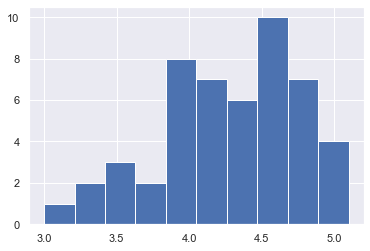

In [126]:
# Import plotting modules
import matplotlib.pyplot as plt

import seaborn as sns
import pandas as pd
from sklearn.datasets import load_iris

df = pd.read_csv('../datasets/iris.csv')

print(df.head())
#('setosa', 'versicolor', 'virginica')
versicolor_petal_length=df[df['species']=='Iris-versicolor']['petal length (cm)']
versicolor_petal_width=df[df['species']=='Iris-versicolor']['petal width (cm)']
setosa_petal_length=df[df['species']=='Iris-setosa']['petal length (cm)']
virginica_petal_length=df[df['species']=='Iris-virginica']['petal length (cm)']
# Set default Seaborn style
sns.set()

# Plot histogram of versicolor petal lengths
plt.hist(versicolor_petal_length)

# Show histogram
plt.show()



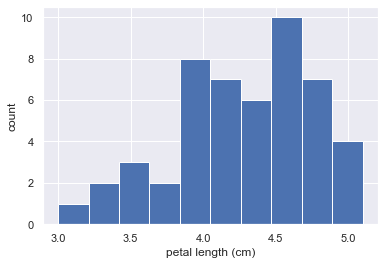

In [127]:
# Plot histogram of versicolor petal lengths
ax = plt.hist(versicolor_petal_length)

# Label axes

plt.xlabel('petal length (cm)')
plt.ylabel('count')
# Show histogram

plt.show()

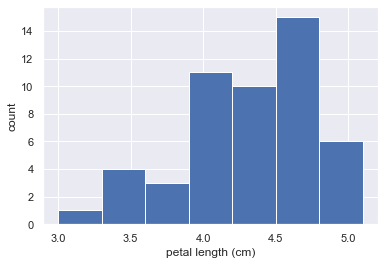

In [128]:
# Import numpy
import numpy as np

# Compute number of data points: n_data
n_data=len(versicolor_petal_length)

# Number of bins is the square root of number of data points: n_bins
bins=np.sqrt(n_data)

# Convert number of bins to integer: n_bins
n_bins=int(bins)

# Plot the histogram
plt.hist(versicolor_petal_length, bins=n_bins)

# Label axes
x = plt.xlabel('petal length (cm)')
y = plt.ylabel('count')

# Show histogram
plt.show()

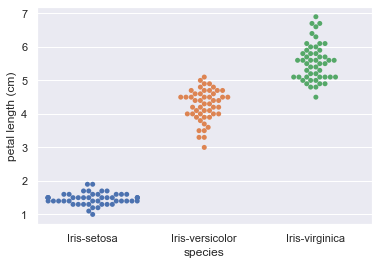

In [129]:
# Create bee swarm plot with Seaborn's default settings
sns.swarmplot(x='species', y='petal length (cm)', data=df)

# Label the axes
plt.xlabel('species')
plt.ylabel('petal length (cm)')
# Show the plot
plt.show()


In [130]:
def ecdf(data):
    """Compute ECDF for a one-dimensional array of measurements."""
    # Number of data points: n
    n = len(data)

    # x-data for the ECDF: x
    x = np.sort(data)

    # y-data for the ECDF: y
    y = np.arange(1, n+1) / n

    return x, y


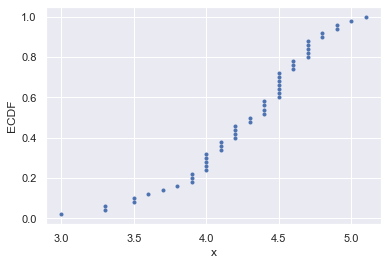

In [131]:
# Compute ECDF for versicolor data: x_vers, y_vers
x_vers, y_vers = ecdf(versicolor_petal_length)

# Generate plot
plt.plot(x_vers, y_vers, linestyle='none', marker='.')

# Label the axes
plt.xlabel('x')
plt.ylabel('ECDF')

# Display the plot
plt.show()


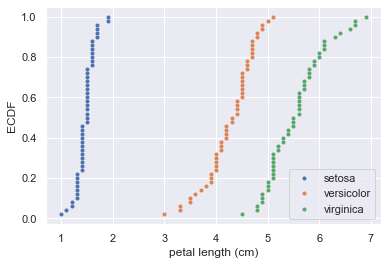

In [132]:
# Compute ECDFs
x_set, y_set=ecdf(setosa_petal_length)
x_vers, y_vers=ecdf(versicolor_petal_length)
x_virg, y_virg=ecdf(virginica_petal_length)

# Plot all ECDFs on the same plot
plt.plot(x_set, y_set, marker='.',linestyle='none',)
plt.plot(x_vers, y_vers, marker='.', linestyle='none',)
plt.plot(x_virg, y_virg, marker='.', linestyle='none',)

# Annotate the plot
plt.legend(('setosa', 'versicolor', 'virginica'), loc='lower right')
_ = plt.xlabel('petal length (cm)')
_ = plt.ylabel('ECDF')

# Display the plot
plt.show()

In [133]:
# Compute the mean: mean_length_vers
mean_length_vers=sum(versicolor_petal_length)/len(versicolor_petal_length)

# Print the result with some nice formatting
print('I. versicolor:', mean_length_vers, 'cm')

I. versicolor: 4.26 cm


In [134]:
"""NOTES:
outlier is not necessarily an errorneous data point.
"""

'NOTES:\noutlier is not necessarily an errorneous data point.\n'

In [135]:
# Specify array of percentiles: percentiles
percentiles=np.array([2.5, 25, 50, 75, 97.5])

# Compute percentiles: ptiles_vers
ptiles_vers= np.percentile(versicolor_petal_length,percentiles)

# Print the result
print(ptiles_vers)

[3.3    4.     4.35   4.6    4.9775]


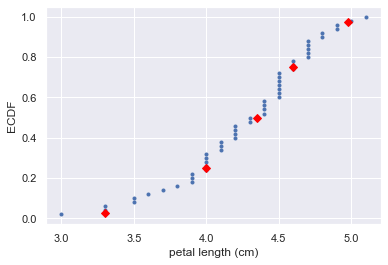

In [136]:
# Plot the ECDF
_ = plt.plot(x_vers, y_vers, '.')
_ = plt.xlabel('petal length (cm)')
_ = plt.ylabel('ECDF')

# Overlay percentiles as red diamonds.
_ = plt.plot(ptiles_vers, percentiles/100, marker='D', color='red',
         linestyle='none')

# Show the plot
plt.show()


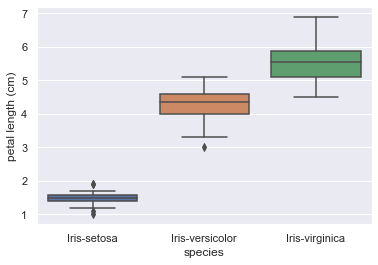

In [137]:
# Create box plot with Seaborn's default settings
_=sns.boxplot(x='species', y='petal length (cm)', data=df)

# Label the axes
plt.xlabel('species')

plt.ylabel('petal length (cm)')
# Show the plot
plt.show()


In [138]:
"""
Create an array called differences that is the difference between the petal lengths (versicolor_petal_length) and the mean petal length. The variable versicolor_petal_length is already in your namespace as a NumPy array so you can take advantage of NumPy's vectorized operations.
Square each element in this array. For example, x**2 squares each element in the array x. Store the result as diff_sq.
Compute the mean of the elements in diff_sq using np.mean(). Store the result as variance_explicit.
Compute the variance of versicolor_petal_length using np.var(). Store the result as variance_np.
Print both variance_explicit and variance_np in one print call to make sure they are consistent.
"""

"\nCreate an array called differences that is the difference between the petal lengths (versicolor_petal_length) and the mean petal length. The variable versicolor_petal_length is already in your namespace as a NumPy array so you can take advantage of NumPy's vectorized operations.\nSquare each element in this array. For example, x**2 squares each element in the array x. Store the result as diff_sq.\nCompute the mean of the elements in diff_sq using np.mean(). Store the result as variance_explicit.\nCompute the variance of versicolor_petal_length using np.var(). Store the result as variance_np.\nPrint both variance_explicit and variance_np in one print call to make sure they are consistent.\n"

In [139]:
# Array of differences to mean: differences
differences=np.array(versicolor_petal_length-np.mean(versicolor_petal_length))

# Square the differences: diff_sq
diff_sq=(differences)**2

# Compute the mean square difference: variance_explicit
variance_explicit=np.mean(diff_sq)

# Compute the variance using NumPy: variance_np
variance_np= np.var(versicolor_petal_length)

# Print the results
print(variance_explicit, variance_np)


0.21640000000000004 0.21640000000000004


In [140]:
"""Compare sqrt of variance = std"""
# Compute the variance: variance
variance=np.var(versicolor_petal_length)

# Print the square root of the variance
print(np.sqrt(variance))

# Print the standard deviation
print(np.std(versicolor_petal_length))


0.4651881339845203
0.4651881339845203


In [141]:
"""Correlation, scatter is fit"""

'Correlation, scatter is fit'

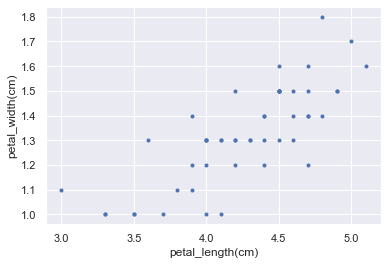

In [142]:
# Make a scatter plot
plt.plot(versicolor_petal_length, versicolor_petal_width, marker='.', linestyle='none')


# Label the axes
plt.xlabel('petal_length(cm)')
plt.ylabel('petal_width(cm)')

# Show the result
plt.show()

In [143]:
# Compute the covariance matrix: covariance_matrix
covariance_matrix=np.cov(versicolor_petal_length, versicolor_petal_width)

# Print covariance matrix
print(covariance_matrix)

# Extract covariance of length and width of petals: petal_cov
petal_cov=covariance_matrix[0,1], covariance_matrix[1,0]
print(covariance_matrix)
# Print the length/width covariance
print(petal_cov)


[[0.22081633 0.07310204]
 [0.07310204 0.03910612]]
[[0.22081633 0.07310204]
 [0.07310204 0.03910612]]
(0.07310204081632653, 0.07310204081632653)


In [144]:
def pearson_r(x, y):
    """Compute Pearson correlation coefficient between two arrays."""
    # Compute correlation matrix: corr_mat
    corr_mat=np.corrcoef(x, y)

    # Return entry [0,1]
    return corr_mat[0,1]

# Compute Pearson correlation coefficient for I. versicolor: r
r= pearson_r(versicolor_petal_length, versicolor_petal_width)

# Print the result
print(r)

0.7866680885228167


In [145]:
"""Probabilistic logic and statistical inference"""

'Probabilistic logic and statistical inference'

In [146]:
"""
Seed the random number generator using the seed 42.
Initialize an empty array, random_numbers, of 100,000 entries to store the random numbers. Make sure you use np.empty(100000) to do this.
Write a for loop to draw 100,000 random numbers using np.random.random(), storing them in the random_numbers array. To do so, loop over range(100000).
Plot a histogram of random_numbers. It is not necessary to label the axes in this case because we are just checking the random number generator. Hit 'Submit Answer' to show your plot.
"""

"\nSeed the random number generator using the seed 42.\nInitialize an empty array, random_numbers, of 100,000 entries to store the random numbers. Make sure you use np.empty(100000) to do this.\nWrite a for loop to draw 100,000 random numbers using np.random.random(), storing them in the random_numbers array. To do so, loop over range(100000).\nPlot a histogram of random_numbers. It is not necessary to label the axes in this case because we are just checking the random number generator. Hit 'Submit Answer' to show your plot.\n"

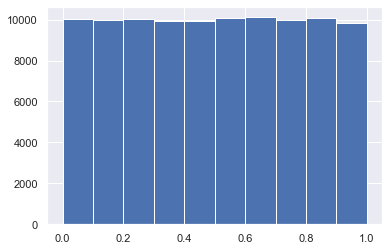

In [147]:
# Seed the random number generator
random_numbers=np.random.seed(42)

# Initialize random numbers: random_numbers
random_numbers = np.empty(100000)

# Generate random numbers by looping over range(100000)
for i in range(0,100000):
    random_numbers[i] = np.random.random()

# Plot a histogram
_ = plt.hist(random_numbers)

# Show the plot
plt.show()


In [148]:
def perform_bernoulli_trials(n, p):
    """Perform n Bernoulli trials with success probability p
    and return number of successes."""
    # Initialize number of successes: n_success
    n_success = 0

    # Perform trials
    for i in range(n):
        # Choose random number between zero and one: random_number
        random_number= np.random.random(1)
    
        # If less than p, it's a success so add one to n_success
        if random_number<p:
            n_success+=1

    return n_success

In [163]:
"""Seed the random number generator to 42.
Initialize n_defaults, an empty array, using np.empty(). It should contain 1000 entries, since we are doing 1000 simulations.
Write a for loop with 1000 iterations to compute the number of defaults per 100 loans using the perform_bernoulli_trials() function. It accepts two arguments: the number of trials n - in this case 100 - and the probability of success p - in this case the probability of a default, which is 0.05. On each iteration of the loop store the result in an entry of n_defaults.
Plot a histogram of n_defaults. Include the normed=True keyword argument so that the height of the bars of the histogram indicate the probability.
Show your plot.
"""

'Seed the random number generator to 42.\nInitialize n_defaults, an empty array, using np.empty(). It should contain 1000 entries, since we are doing 1000 simulations.\nWrite a for loop with 1000 iterations to compute the number of defaults per 100 loans using the perform_bernoulli_trials() function. It accepts two arguments: the number of trials n - in this case 100 - and the probability of success p - in this case the probability of a default, which is 0.05. On each iteration of the loop store the result in an entry of n_defaults.\nPlot a histogram of n_defaults. Include the normed=True keyword argument so that the height of the bars of the histogram indicate the probability.\nShow your plot.\n'

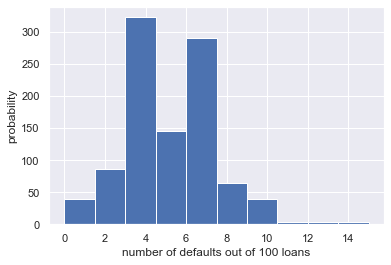

In [173]:
# Seed random number generator
n_defaults=np.random.seed(42)

# Initialize the number of defaults: n_defaults
n_defaults=np.empty(1000)

# Compute the number of defaults
for i in range(1000):
    n_defaults[i] = perform_bernoulli_trials(100, 0.05)


# Plot the histogram with default number of bins; label your axes
_ = plt.hist(n_defaults)
_ = plt.xlabel('number of defaults out of 100 loans')
_ = plt.ylabel('probability')

# Show the plot
plt.show()

In [151]:
"""
Compute the x and y values for the ECDF of n_defaults.
Plot the ECDF, making sure to label the axes. Remember to include marker = '.' and linestyle = 'none' in addition to x and y in your call plt.plot().
Show the plot.
Compute the total number of entries in your n_defaults array that were greater than or equal to 10. To do so, compute a boolean array that tells you whether a given entry of n_defaults is >= 10. Then sum all the entries in this array using np.sum(). For example, np.sum(n_defaults <= 5) would compute the number of defaults with 5 or fewer defaults.
The probability that the bank loses money is the fraction of n_defaults that are greater than or equal to 10. Print this result by hitting 'Submit Answer'!
"""

"\nCompute the x and y values for the ECDF of n_defaults.\nPlot the ECDF, making sure to label the axes. Remember to include marker = '.' and linestyle = 'none' in addition to x and y in your call plt.plot().\nShow the plot.\nCompute the total number of entries in your n_defaults array that were greater than or equal to 10. To do so, compute a boolean array that tells you whether a given entry of n_defaults is >= 10. Then sum all the entries in this array using np.sum(). For example, np.sum(n_defaults <= 5) would compute the number of defaults with 5 or fewer defaults.\nThe probability that the bank loses money is the fraction of n_defaults that are greater than or equal to 10. Print this result by hitting 'Submit Answer'!\n"

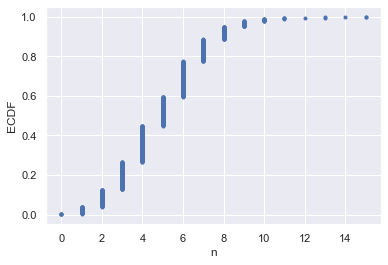

Probability of losing money = 0.022


In [174]:
# Compute ECDF: x, y
x,y=ecdf(n_defaults)

# Plot the ECDF with labeled axes
plt.plot(x,y,marker='.', linestyle='none')
plt.xlabel('n')
plt.ylabel('ECDF')

# Show the plot
plt.show()

# Compute the number of 100-loan simulations with 10 or more defaults: n_lose_money
n_lose_money= np.sum(n_defaults>=10)

# Compute and print probability of losing money
print('Probability of losing money =', n_lose_money / len(n_defaults))


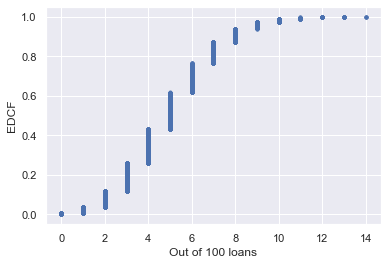

In [153]:
# Take 10,000 samples out of the binomial distribution: n_defaults
n_defaults= np.random.binomial(100, 0.05, size=10000)

# Compute CDF: x, y
x,y=ecdf(n_defaults)

# Plot the CDF with axis labels
plt.plot(x,y, marker='.', linestyle='none')
plt.xlabel('Out of 100 loans')
plt.ylabel('EDCF')

# Show the plot
plt.show()


In [154]:
"""
Using np.arange(), compute the bin edges such that the bins are centered on the integers. Store the resulting array in the variable bins.
Use plt.hist() to plot the histogram of n_defaults with the normed=True and bins=bins keyword arguments.
Show the plot.
"""

'\nUsing np.arange(), compute the bin edges such that the bins are centered on the integers. Store the resulting array in the variable bins.\nUse plt.hist() to plot the histogram of n_defaults with the normed=True and bins=bins keyword arguments.\nShow the plot.\n'

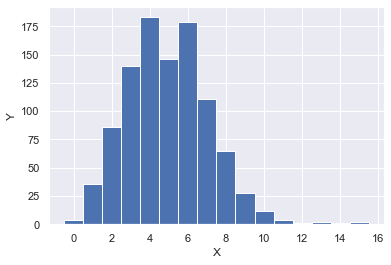

In [176]:
# Compute bin edges: bins
bins = np.arange(min(n_defaults), max(n_defaults) + 1.5) - 0.5

# Generate histogram
plt.hist(n_defaults, bins=bins)

# Label axes
plt.xlabel("X")
plt.ylabel("Y")

# Show the plot
plt.show()

In [156]:
#Poisson distribution
"""
The number r of arrivals of a Poisson process in a given time interval with average rate of? arrivals per interval is Poission distrbuted.
The number of r of hits on a website in one hour with an average hit rate of 6 hits per hour is Poission distributed.
"""
"""Limit of the Binomial distribution for low propability of success and large number of trials.
That is, for rare events.
"""

'Limit of the Binomial distribution for low propability of success and large number of trials.\nThat is, for rare events.\n'

In [177]:
#Using the np.random.poisson() function, draw 10000 samples from a Poisson distribution with a mean of 10.
# Draw 10,000 samples out of Poisson distribution: samples_poisson
samples_poisson=np.random.poisson(10, 10000)

# Print the mean and standard deviation
print('Poisson:     ', np.mean(samples_poisson),
                       np.std(samples_poisson))

# Specify values of n and p to consider for Binomial: n, p
n=[20,100,1000]
p=[0.5,0.1,0.01]

# Draw 10,000 samples for each n,p pair: samples_binomial
for i in range(3):
    samples_binomial = np.random.binomial(n[i], p[i], size=10000)

    # Print results
    print('n =', n[i], 'Binom:', np.mean(samples_binomial),
                                 np.std(samples_binomial))


Poisson:      9.9881 3.1578407797100856
n = 20 Binom: 10.0222 2.2492014494037655
n = 100 Binom: 10.0776 3.0122712759643675
n = 1000 Binom: 10.0481 3.1480130860592053


In [178]:
# Draw 10,000 samples out of Poisson distribution: n_nohitters
n_nohitters= np.random.poisson(251/115, 10000)

# Compute number of samples that are seven or greater: n_large
n_large = np.sum(n_nohitters>=7)

# Compute probability of getting seven or more: p_large
p_large= n_large/ (len(n_nohitters))

# Print the result
print('Probability of seven or more no-hitters:', p_large)
print(p_large)

Probability of seven or more no-hitters: 0.0071
0.0071


In [159]:
"""Draw 100,000 samples from a Normal distribution that has a mean of 20 and a standard deviation of 1. Do the same for Normal distributions with standard deviations of 3 and 10, each still with a mean of 20. Assign the results to samples_std1, samples_std3 and samples_std10, respectively.
Plot a histograms of each of the samples; for each, use 100 bins, also using the keyword arguments normed=True and histtype='step'. The latter keyword argument makes the plot look much like the smooth theoretical PDF. You will need to make 3 plt.hist() calls.
Hit 'Submit Answer' to make a legend, showing which standard deviations you used, and show your plot! There is no need to label the axes because we have not defined what is being described by the Normal distribution; we are just looking at shapes of PDFs.
"""

"Draw 100,000 samples from a Normal distribution that has a mean of 20 and a standard deviation of 1. Do the same for Normal distributions with standard deviations of 3 and 10, each still with a mean of 20. Assign the results to samples_std1, samples_std3 and samples_std10, respectively.\nPlot a histograms of each of the samples; for each, use 100 bins, also using the keyword arguments normed=True and histtype='step'. The latter keyword argument makes the plot look much like the smooth theoretical PDF. You will need to make 3 plt.hist() calls.\nHit 'Submit Answer' to make a legend, showing which standard deviations you used, and show your plot! There is no need to label the axes because we have not defined what is being described by the Normal distribution; we are just looking at shapes of PDFs.\n"

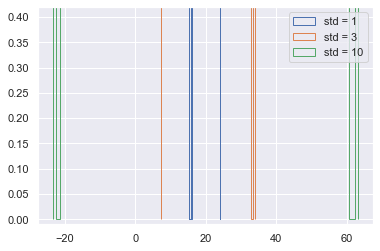

In [180]:
# Draw 100000 samples from Normal distribution with stds of interest: samples_std1, samples_std3, samples_std10
samples_std1=np.random.normal(20, 1, 100000)
samples_std3=np.random.normal(20, 3, 100000)
samples_std10=np.random.normal(20, 10, 100000)


# Make histograms
plt.hist(samples_std1,histtype='step', bins=100 )
plt.hist(samples_std3, histtype='step' , bins=100 )
plt.hist(samples_std10, histtype='step', bins=100  )

# Make a legend, set limits and show plot
_ = plt.legend(('std = 1', 'std = 3', 'std = 10'))
plt.ylim(-0.01, 0.42)
plt.show()


In [161]:
"""
Use your ecdf() function to generate x and y values for CDFs: x_std1, y_std1, x_std3, y_std3 and x_std10, y_std10, respectively.
Plot all three CDFs as dots (do not forget the marker and linestyle keyword arguments!).
Hit submit to make a legend, showing which standard deviations you used, and to show your plot. There is no need to label the axes because we have not defined what is being described by the Normal distribution; we are just looking at shapes of CDFs.
"""

'\nUse your ecdf() function to generate x and y values for CDFs: x_std1, y_std1, x_std3, y_std3 and x_std10, y_std10, respectively.\nPlot all three CDFs as dots (do not forget the marker and linestyle keyword arguments!).\nHit submit to make a legend, showing which standard deviations you used, and to show your plot. There is no need to label the axes because we have not defined what is being described by the Normal distribution; we are just looking at shapes of CDFs.\n'

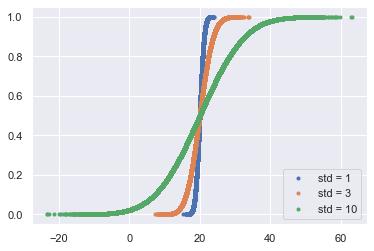

In [182]:
# Generate CDFs
x_std1, y_std1=ecdf(samples_std1)
x_std3, y_std3=ecdf(samples_std3)
x_std10, y_std10=ecdf(samples_std10)

# Plot CDFs
plt.plot(x_std1,y_std1, marker='.', linestyle='none')
plt.plot(x_std3,y_std3, marker='.', linestyle='none')
plt.plot(x_std10,y_std10, marker='.', linestyle='none')
# Make a legend and show the plot
_ = plt.legend(('std = 1', 'std = 3', 'std = 10'), loc='lower right')
plt.show()


In [185]:
df=pd.read_csv('../datasets/belmont.csv')
df = df[df['Year'].apply(lambda x: x not in [1973, 1970])]
df['length'] = df['Time'].apply(lambda x: int(x.split(':')[0])*60+float(x.split(':')[1]))
belmont_no_outliers = df['length']
print(belmont_no_outliers)


0     148.51
1     146.65
2     148.52
3     150.70
4     150.42
       ...  
86    151.60
87    152.80
88    153.20
89    152.40
90    152.20
Name: length, Length: 89, dtype: float64


In [ ]:
"""
Compute mean and standard deviation of Belmont winners' times with the two outliers removed. The NumPy array belmont_no_outliers has these data.
Take 10,000 samples out of a normal distribution with this mean and standard deviation using np.random.normal().
Compute the CDF of the theoretical samples and the ECDF of the Belmont winners' data, assigning the results to x_theor, y_theor and x, y, respectively.
Hit submit to plot the CDF of your samples with the ECDF, label your axes and show the plot.
"""

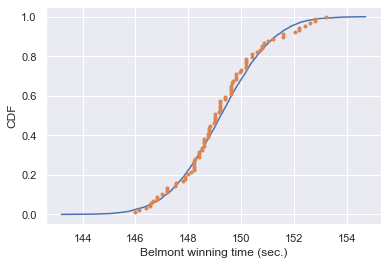

In [186]:
# Compute mean and standard deviation: mu, sigma
mu=np.mean(belmont_no_outliers)
sigma=np.std(belmont_no_outliers)

# Sample out of a normal distribution with this mu and sigma: samples
samples= np.random.normal(mu, sigma, 10000)

# Get the CDF of the samples and of the data
x,y= ecdf(belmont_no_outliers)
x_theor, y_theor=ecdf(samples)

# Plot the CDFs and show the plot
_ = plt.plot(x_theor, y_theor)
_ = plt.plot(x, y, marker='.', linestyle='none')
_ = plt.xlabel('Belmont winning time (sec.)')
_ = plt.ylabel('CDF')
plt.show()


In [167]:
"""
Take 1,000,000 samples from the normal distribution using the np.random.normal() function. The mean mu and standard deviation sigma are already loaded into the namespace of your IPython instance.
Compute the fraction of samples that have a time less than or equal to Secretariat's time of 144 seconds.
Print the result.
"""

"\nTake 1,000,000 samples from the normal distribution using the np.random.normal() function. The mean mu and standard deviation sigma are already loaded into the namespace of your IPython instance.\nCompute the fraction of samples that have a time less than or equal to Secretariat's time of 144 seconds.\nPrint the result.\n"

In [187]:
# Take a million samples out of the Normal distribution: samples
samples=np.random.normal(mu, sigma, 1000000)

# Compute the fraction that are faster than 144 seconds: prob
prob=np.sum(samples<=144)/len(samples)

# Print the result
print('Probability of besting Secretariat:', prob)


Probability of besting Secretariat: 0.000624


In [169]:
"""
Define a function with call signature successive_poisson(tau1, tau2, size=1) that samples the waiting time for a no-hitter and a hit of the cycle.
Draw waiting times tau1 (size number of samples) for the no-hitter out of an exponential distribution and assign to t1.
Draw waiting times tau2 (size number of samples) for hitting the cycle out of an exponential distribution and assign to t2.
The function returns the sum of the waiting times for the two events.
"""

'\nDefine a function with call signature successive_poisson(tau1, tau2, size=1) that samples the waiting time for a no-hitter and a hit of the cycle.\nDraw waiting times tau1 (size number of samples) for the no-hitter out of an exponential distribution and assign to t1.\nDraw waiting times tau2 (size number of samples) for hitting the cycle out of an exponential distribution and assign to t2.\nThe function returns the sum of the waiting times for the two events.\n'

In [188]:
def successive_poisson(tau1, tau2, size=1):
    """Compute time for arrival of 2 successive Poisson processes."""
    # Draw samples out of first exponential distribution: t1
    t1 = np.random.exponential(tau1,size)

    # Draw samples out of second exponential distribution: t2
    t2 =  np.random.exponential(tau2,size)

    return t1 + t2

In [171]:
"""
Use your successive_poisson() function to draw 100,000 out of the distribution of waiting times for observing a no-hitter and a hitting of the cycle.
Plot the PDF of the waiting times using the step histogram technique of a previous exercise. Don't forget the necessary keyword arguments. You should use bins=100, normed=True, and histtype='step'.
Label the axes.
Show your plot.
"""

"\nUse your successive_poisson() function to draw 100,000 out of the distribution of waiting times for observing a no-hitter and a hitting of the cycle.\nPlot the PDF of the waiting times using the step histogram technique of a previous exercise. Don't forget the necessary keyword arguments. You should use bins=100, normed=True, and histtype='step'.\nLabel the axes.\nShow your plot.\n"

In [189]:
# Draw samples of waiting times
waiting_times = successive_poisson(764, 715, size=100000)

# Make the histogram
_ = plt.hist(waiting_times, bins=100, histtype='step')

# Label axes
_ = plt.xlabel('total waiting time (games)')
_ = plt.ylabel('PDF')

# Show the plot
plt.show()


AttributeError: 'Polygon' object has no property 'normed'